In [ ]:
! git clone https://github.com/WongKinYiu/yolov7.git

Cloning into 'yolov7'...
remote: Enumerating objects: 998, done.
remote: Total 998 (delta 0), reused 0 (delta 0), pack-reused 998
Receiving objects: 100% (998/998), 69.77 MiB | 16.93 MiB/s, done.
Resolving deltas: 100% (467/467), done.


In [ ]:
%cd yolov7

/content/yolov7


In [ ]:
! curl -L https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-w6-pose.pt -o yolov7-w6-pose.pt

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  153M  100  153M    0     0  9291k      0  0:00:16  0:00:16 --:--:-- 9037k


In [ ]:
! pip install --upgrade pip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.1 MB 27.5 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 21.1.3
    Uninstalling pip-21.1.3:
      Successfully uninstalled pip-21.1.3


In [ ]:
pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.4 MB/s eta 0:00:00


In [ ]:
import torch
from torchvision import transforms

from utils.datasets import letterbox
from utils.general import non_max_suppression_kpt
from utils.plots import output_to_keypoint, plot_skeleton_kpts

import matplotlib.pyplot as plt
import cv2
import numpy as np

In [ ]:
!pwd

/content/yolov7


In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

def load_model():
    model = torch.load('yolov7-w6-pose.pt', map_location=device)['model']
    # Put in inference mode
    model.float().eval()

    if torch.cuda.is_available():
        # half() turns predictions into float16 tensors
        # which significantly lowers inference time
        model.half().to(device)
    return model

model = load_model()

In [ ]:
def run_inference(image):
    # Resize and pad image
    image = letterbox(image, 960, stride=64, auto=True)[0] # shape: (567, 960, 3)
    # Apply transforms
    image = transforms.ToTensor()(image) # torch.Size([3, 567, 960])
    if torch.cuda.is_available():
      image = image.half().to(device)
    # Turn image into batch
    image = image.unsqueeze(0) # torch.Size([1, 3, 567, 960])
    with torch.no_grad():
      output, _ = model(image)
    return output, image

In [ ]:
def draw_keypoints(output, image):
  output = non_max_suppression_kpt(output, 
                                     0.25, # Confidence Threshold
                                     0.65, # IoU Threshold
                                     nc=model.yaml['nc'], # Number of Classes
                                     nkpt=model.yaml['nkpt'], # Number of Keypoints
                                     kpt_label=True)
  with torch.no_grad():
        output = output_to_keypoint(output)
  nimg = image[0].permute(1, 2, 0) * 255
  nimg = nimg.cpu().numpy().astype(np.uint8)
  nimg = cv2.cvtColor(nimg, cv2.COLOR_RGB2BGR)
  for idx in range(output.shape[0]):
      plot_skeleton_kpts(nimg, output[idx, 7:].T, 3)

  return nimg

In [ ]:
from google.colab.patches import cv2_imshow

def pose_estimation_video(filename):
    cap = cv2.VideoCapture(filename)
    # VideoWriter for saving the video
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    out = cv2.VideoWriter('football_pose_estimation.mp4', fourcc, 30.0, (int(cap.get(3)), int(cap.get(4))))
    while cap.isOpened():
        (ret, frame) = cap.read()
        if ret == True:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            output, frame = run_inference(frame)
            frame = draw_keypoints(output, frame)
            frame = cv2.resize(frame, (int(cap.get(3)), int(cap.get(4))))
            out.write(frame)
            cv2_imshow(frame)
        else:
            break

        if cv2.waitKey(10) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()     

/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


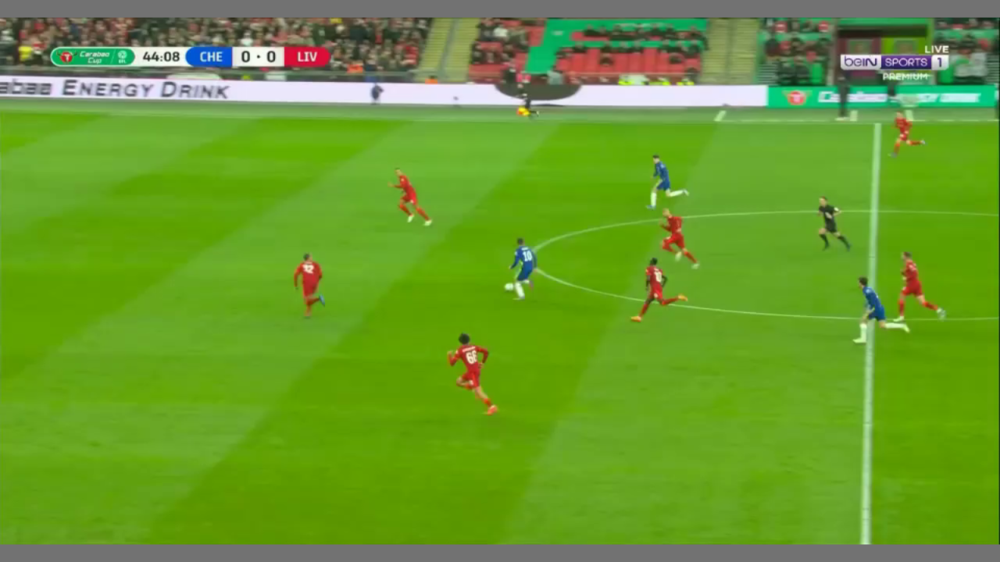

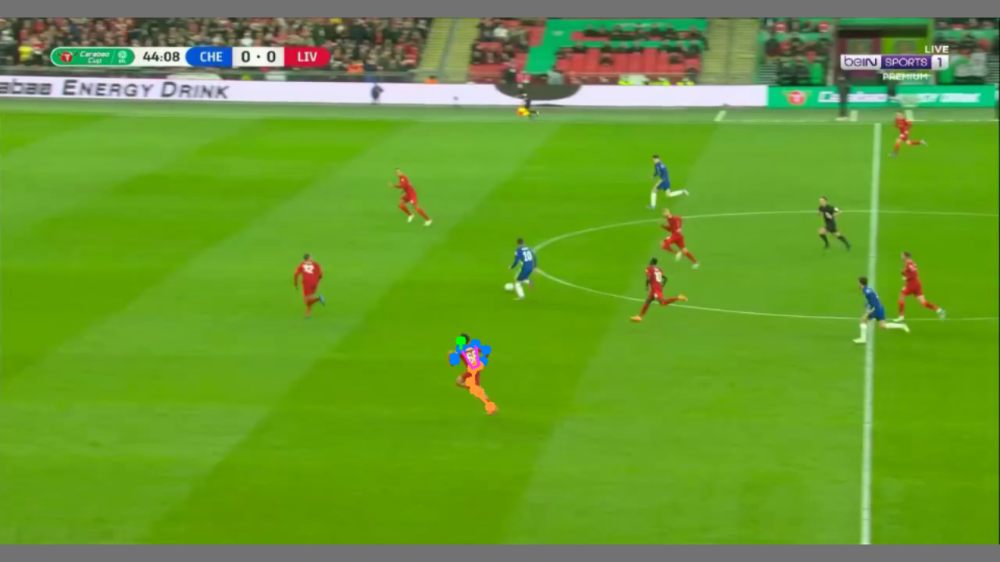

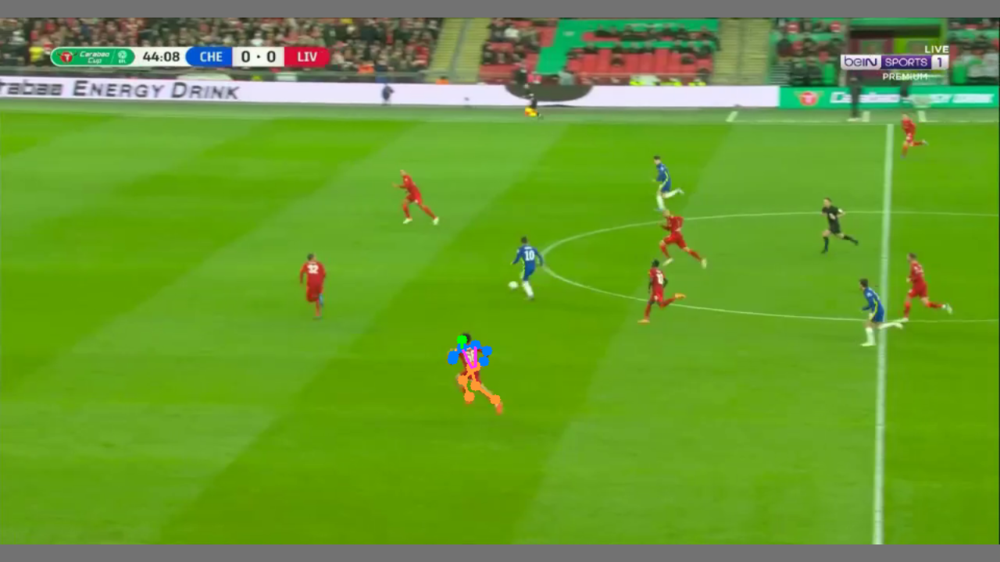

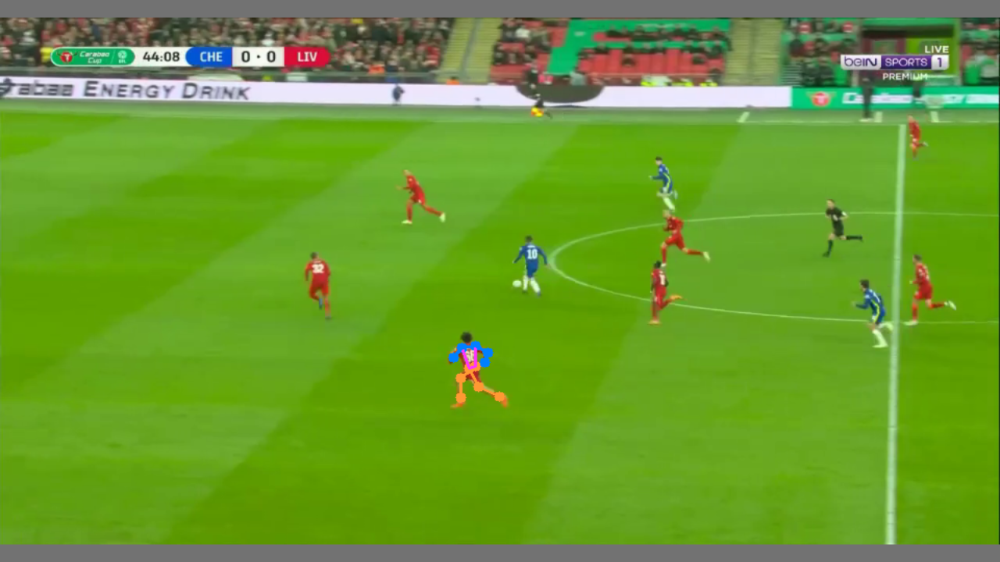

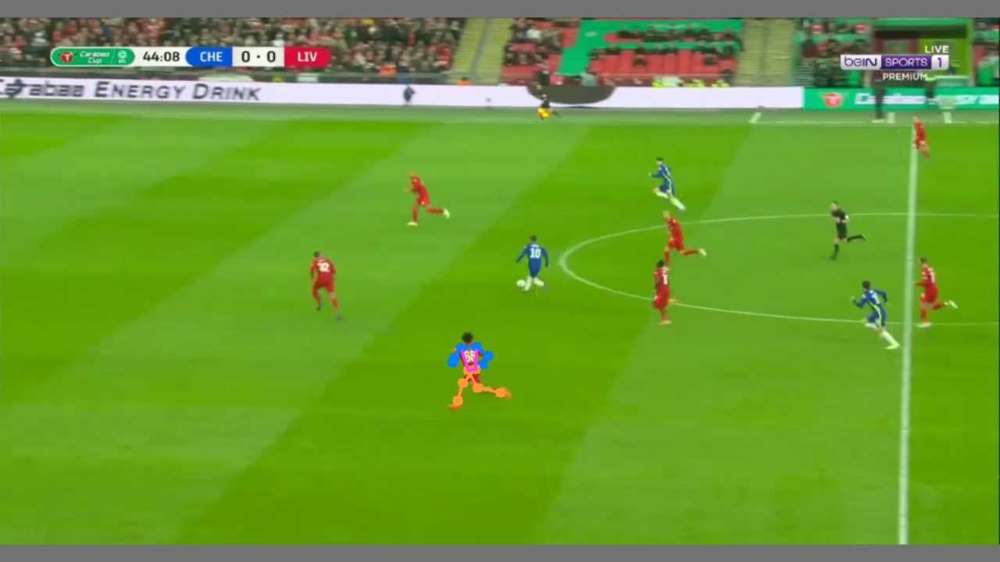

...

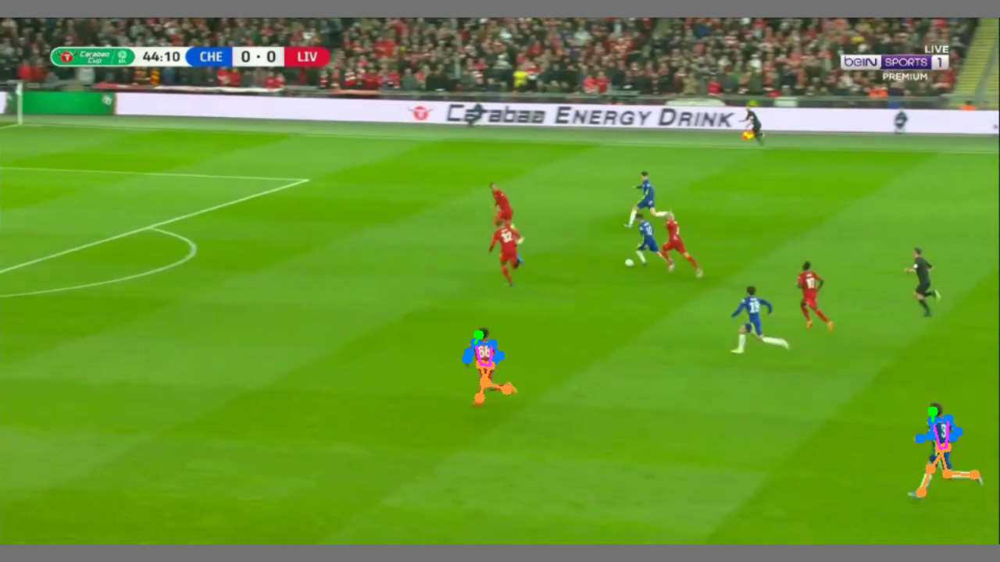

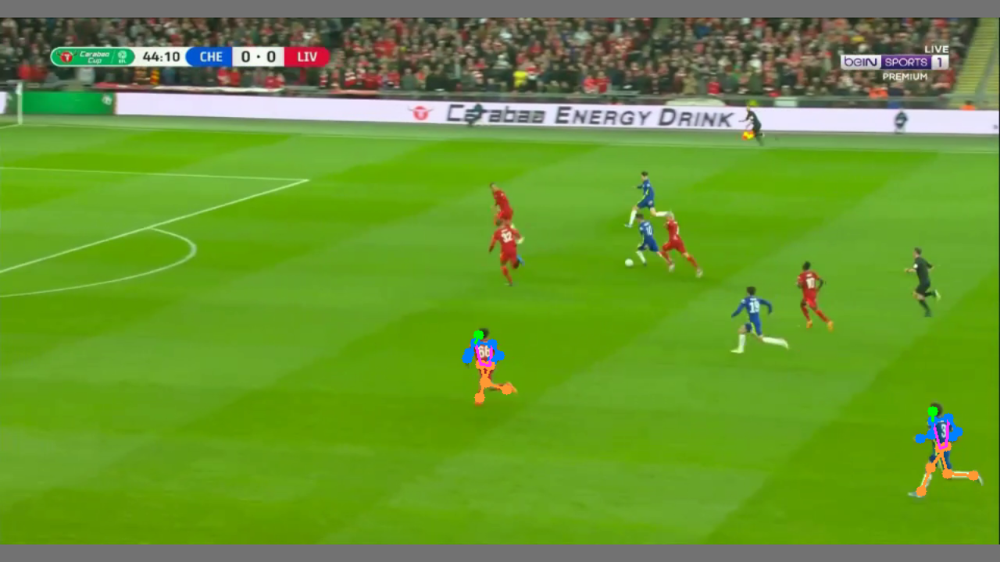

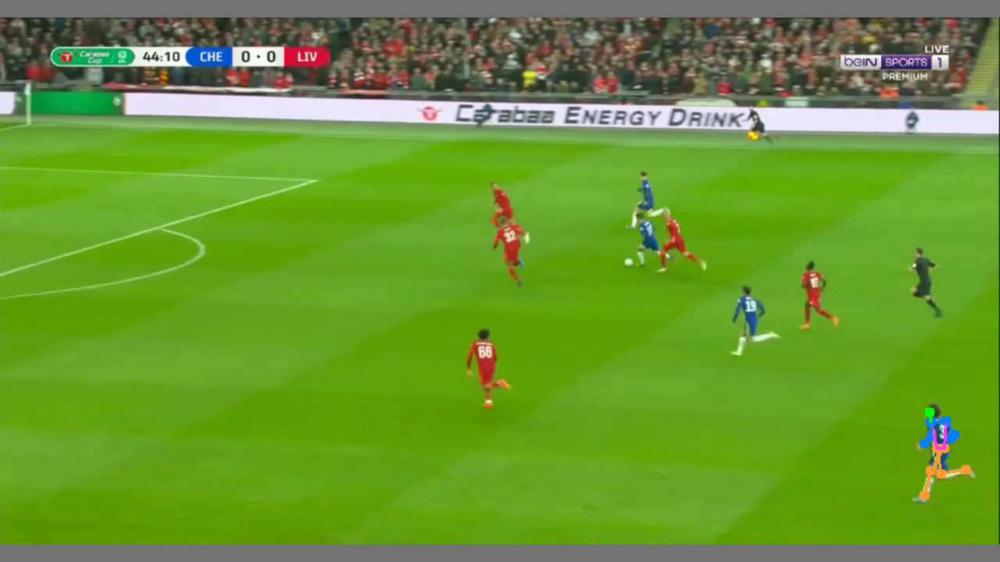

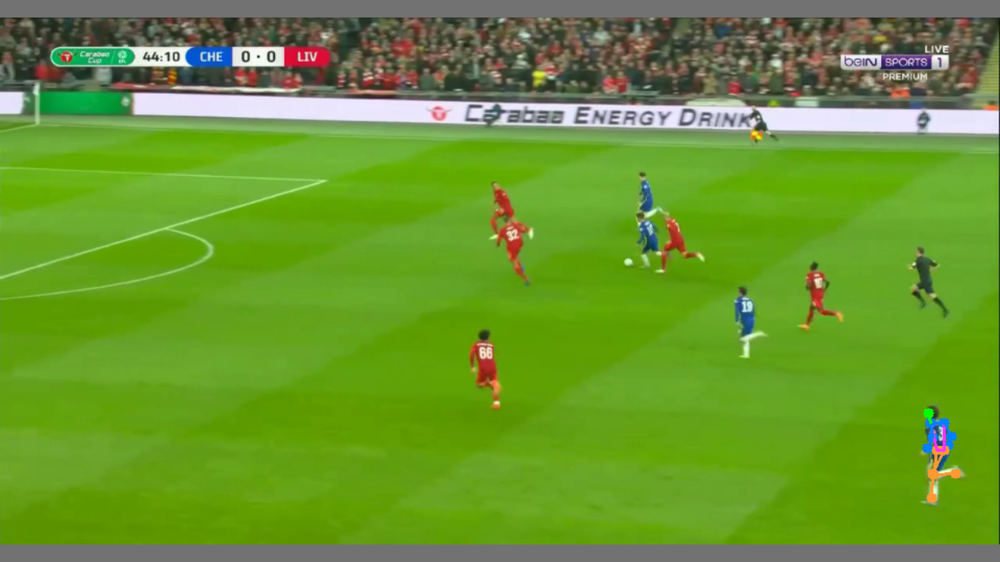

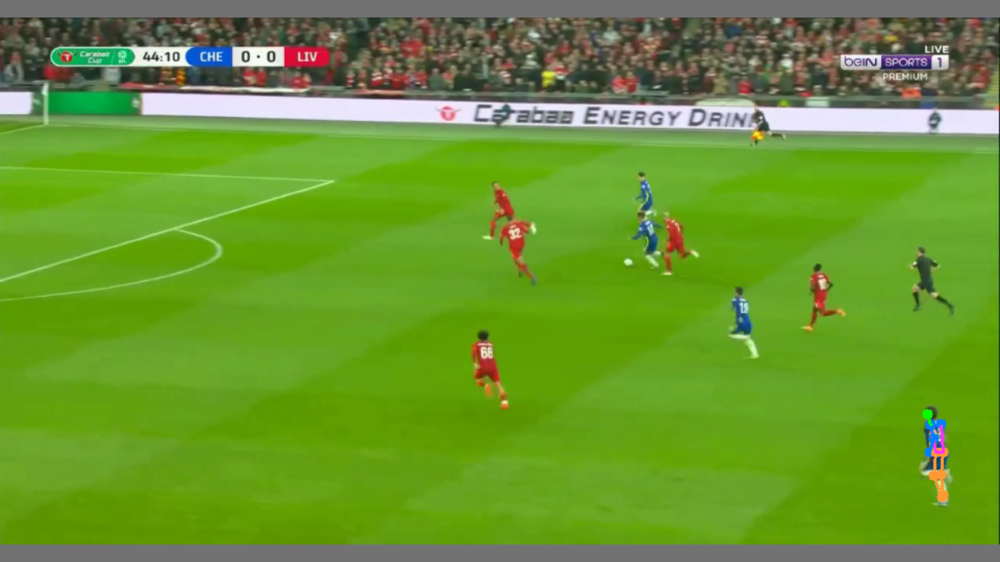

Buffered data was truncated after reaching the output size limit.

In [ ]:
pose_estimation_video('/content/3rd_trim.mp4')